Use the starter notebook and write code to help you: 
1. Specify an ML model that can understand both images and text into Weaviate
2. Add the provided data to your vector database - feel free to use your own images for this aswell!
3. Search the data with a text query
4. Search the data with an image query.

In [8]:
import pickle, weaviate, json, os, IPython

### We first need to start a local instance of Weaviate using Docker.

1. This can be done by opening up a terminal in the folder with the provided `docker-compose.yml` file in it and typing:
```bash
docker compose up
```

2. Later, in order to bring Weaviate down you can just go into this terminal window and type `Ctrl + C`

In [3]:
!pip install -U weaviate-client  # For beta versions:

In [9]:
#Connect to locally hosted Weaviate and check if everything is ready

client = weaviate.Client("http://localhost:8080")

print(f"Client created? {client.is_ready()}")

Client created? True


### Q1: Specify an ML model that can understand both images and text into Weaviate

In [10]:
#Delete the schema if it alredy exists
if client.schema.exists("TextImageSearch"):
    client.schema.delete_class("TextImageSearch")

In [11]:
#To do this we need to specify a schema in which we can specify the model to be used
# aswell as the properties. 

class_obj = {
    'class':"TextImageSearch",
    'moduleConfig' :{
        'multi2vec-clip':{"imageFields":['image']}
    },
    
    'vectorizer': 'multi2vec-clip',
    
    'properties' : [{'name': "text", "dataType": ['string']},
                   {'name': 'image', "dataType": ['blob']}
                   ]
}

client.schema.create_class(class_obj)
print("Schema class created")

Schema class created


### Q2: Add the provided data to your vector database - feel free to use your own images for this aswell!

In [12]:
# Here we will pass in a larger dataset into a folder called "Images"

#If you'd like to add your own images to the vector database to search over
# feel free to add them into this folder aswell!

for img in os.listdir("/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/Images/"):
    
    print(f"Adding image: {img}")
    
    encoded_image = weaviate.util.image_encoder_b64(f'/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/Images/{img}')
    
    data_properties = {
        'image': encoded_image,
        'text' : img
    }
    
    client.data_object.create(data_properties, class_name="TextImageSearch")
    
print("All images added!")

Adding image: Conservatory_LIL_9680.jpg
Adding image: Ornate furniture_LIL_134195.jpg
Adding image: Spiral staircase_LIL_134156.jpg
Adding image: Cat_LIL_134138.jpg
Adding image: Deer_LIL_134180.jpg
Adding image: Walking dog on beach_LIL_134163.jpg
Adding image: Stack of books_LIL_134182.jpg
Adding image: Microphone_LIL_134215.jpg
Adding image: Reading outside_LIL_134129.jpg
Adding image: Golden Gate Bridge from Presidio_LIL_9682.jpg
Adding image: Single cyclist with land background_LIL_9376.dng
Adding image: Llama_LIL_134178.jpg
Adding image: Joshua Tree and California coast_LIL_9670.jpg
Adding image: Dog in motion_LIL_134175.jpg
Adding image: Big Sur_ California_LIL_9678.jpg
Adding image: Wearing a white dress _LIL_134222.jpg
Adding image: Blue sky between skyscrapers_LIL_134160.jpg
Adding image: Feet under a skirt_LIL_134201.jpg
Adding image: Forest_LIL_134133.jpg
Adding image: Point Reyes_ California_LIL_9672.jpg
Adding image: Kitchen scene_LIL_134191.jpg
Adding image: Pies and dis

### Q3. Search the data with a text query

In [30]:
res = (
    client.query
    .get("TextImageSearch", ['text', '_additional {distance}'])
    .with_near_text({'concepts':['cute cats outdoors']})
    .with_limit(3)
    .do()
)

print(json.dumps(res,indent=2))

{
  "data": {
    "Get": {
      "TextImageSearch": [
        {
          "_additional": {
            "distance": 0.75893056
          },
          "text": "Cats on a chair_LIL_134151.jpg"
        },
        {
          "_additional": {
            "distance": 0.7626053
          },
          "text": "Cat_LIL_134138.jpg"
        },
        {
          "_additional": {
            "distance": 0.79710746
          },
          "text": "Bird feeder_LIL_134172.jpg"
        }
      ]
    }
  }
}


**Visualize some of the returned images:**

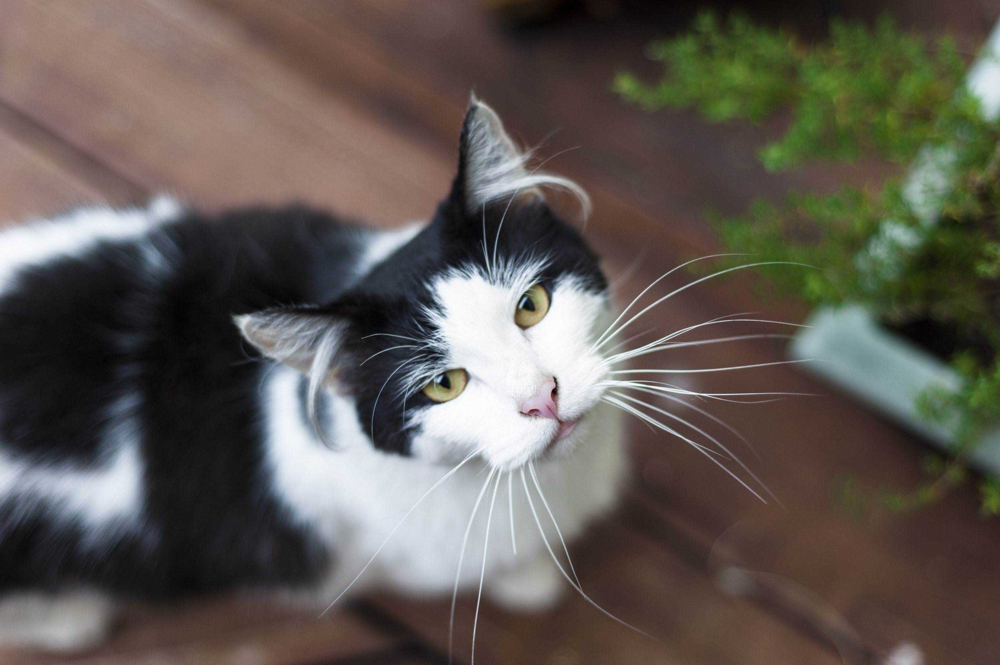

In [41]:
IPython.display.Image(filename='/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/TestImages/Cat_outside_LIL_134200.jpg', width=300)

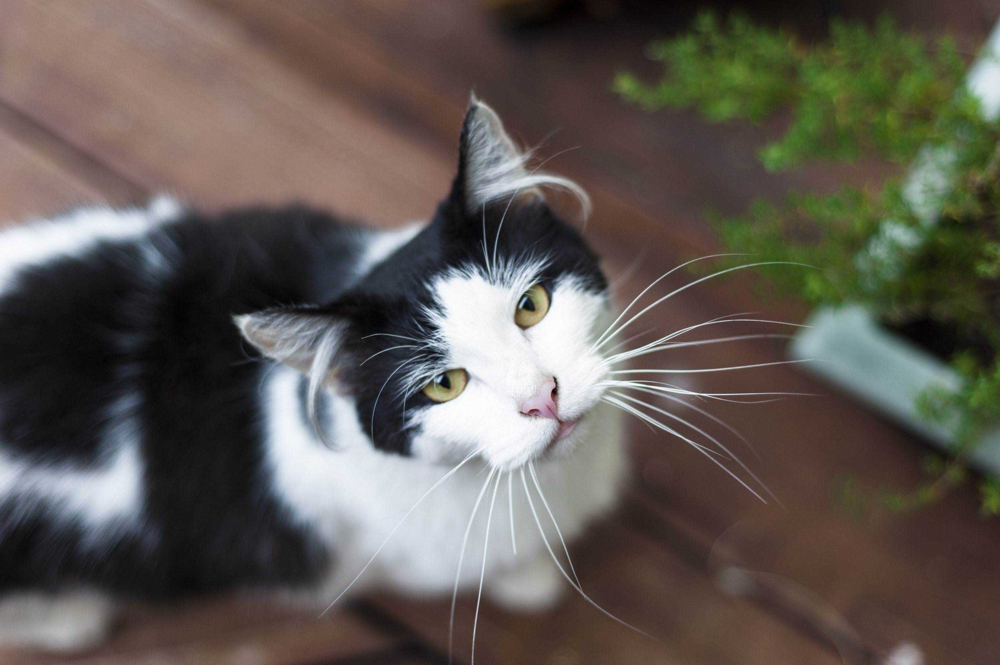

In [47]:
IPython.display.Image(filename='/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/TestImages/Cat_outside_LIL_134200.jpg', width=300)

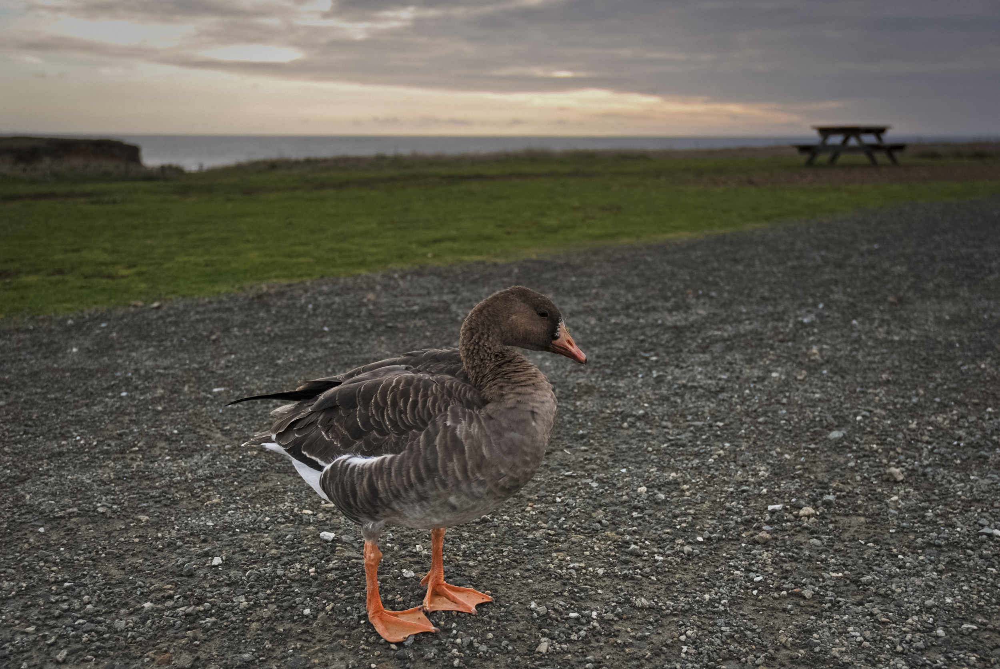

In [48]:
IPython.display.Image(filename='/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/TestImages/Duck_LIL_134179.jpg', width=300)

### Feel free to perform more searches and see if you can explain why specific text search queries return images! 

#### You've sucessfully used a vector database to build text-to-image search!

### Q4. Search the data with an image query.

- **Here we will pass in images that are not in the vector database and search for the most similar images as determined by vector search** 

- **These images can be found in the `TestImages` folder. Feel free to provide your own images as search queries here aswell!**

#### First visualize the image you want to query the database with:

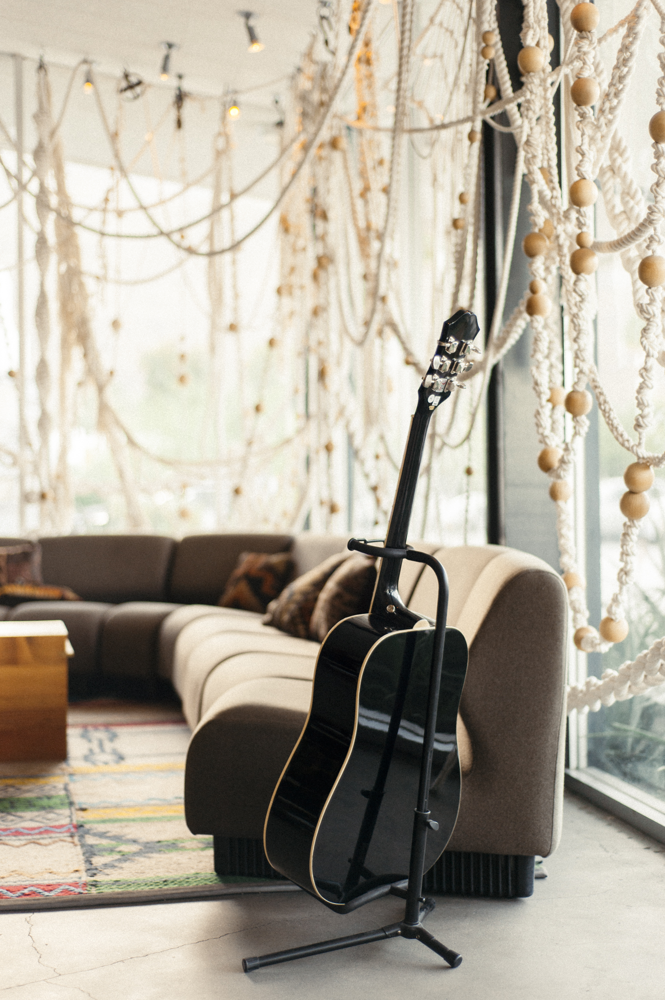

In [50]:
IPython.display.Image(filename='/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/TestImages/Guitar_LIL_134218.jpg', width=300) 

#### Now let's write a query to search using this image:

In [51]:
imres = (client.query
         .get('TextImageSearch', ['text', '_additional {distance}'])
         .with_near_image({'image' : '/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/TestImages/Laundromat_LIL_134220.jpg'})
         .with_limit(3)
         .do()
)

print(json.dumps(imres,indent=2))

{
  "data": {
    "Get": {
      "TextImageSearch": [
        {
          "_additional": {
            "distance": 0.32135534
          },
          "text": "Stack of books_LIL_134182.jpg"
        },
        {
          "_additional": {
            "distance": 0.35121232
          },
          "text": "Onlookers contemplating_LIL_134225.jpg"
        },
        {
          "_additional": {
            "distance": 0.35511118
          },
          "text": "Speaker_LIL_134226.jpg"
        }
      ]
    }
  }
}


**Visualize the images most similar to the input image**

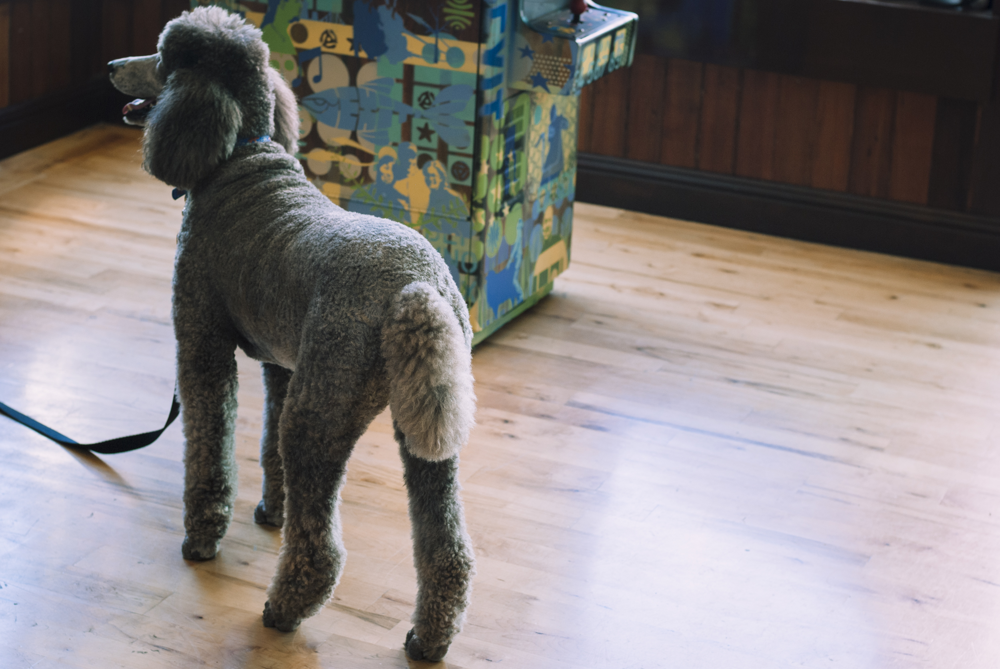

In [53]:
IPython.display.Image(filename='/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/TestImages/Dog_LIL_134140.jpg', width=300)

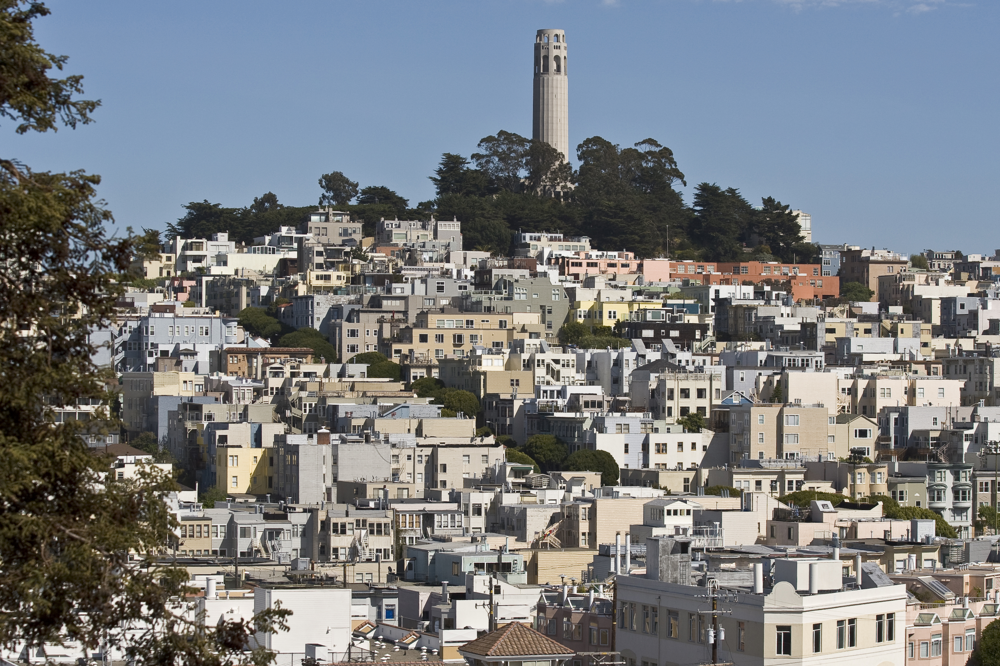

In [54]:
IPython.display.Image(filename='/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/TestImages/Coit_Tower_LIL_9679.jpg', width=300)

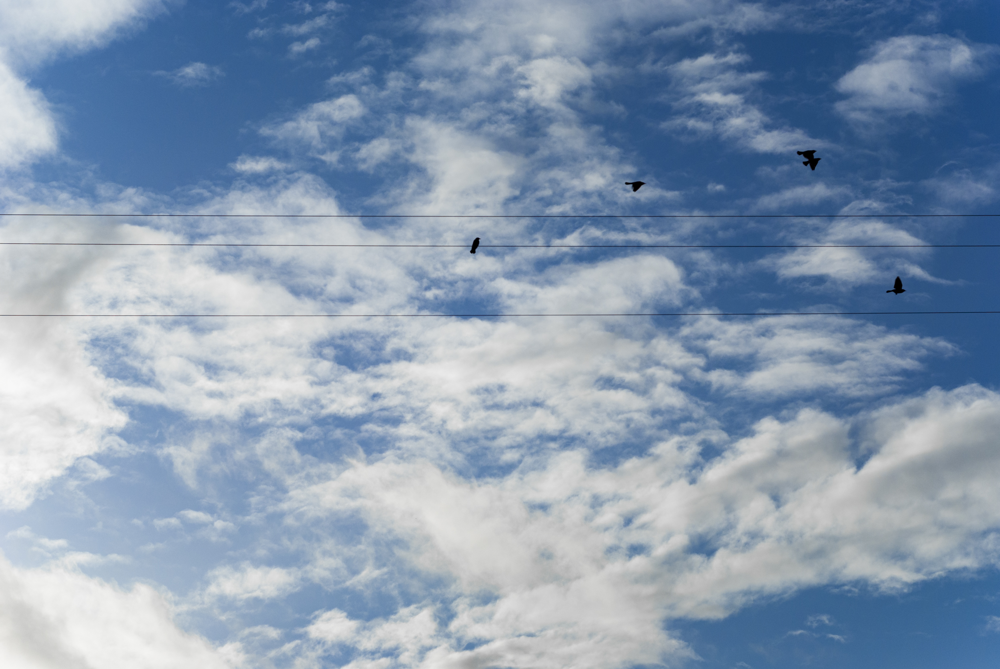

In [58]:
IPython.display.Image(filename='/workspaces/introduction-to-ai-native-vector-databases-4470531/03_03/TestImages/Birds_on_utility_lines_LIL_134174.jpg', width=300)